### Libray importing & etc

In [2]:
%reload autoreload
%autoreload 2
%matplotlib inline

UsageError: Line magic function `%reload` not found.


In [6]:
import matplotlib.pyplot as plt
from matplotlib import rcParams
import numpy as np
from pathlib import Path
import pandas as pd
import seaborn as sns
import warnings

In [42]:
rcParams['figure.figsize'] = (16, 8)
plt.style.use('fivethirtyeight')
pd.set_option('max_columns', 100)
pd.set_option("display.precision", 4)
warnings.simplefilter('ignore')

### Data loading

In [ ]:
data_dir=Path('../input/')
trn_file = data_dir / 'train.csv'
tst_file = data_dir / 'test.csv'
feature_file = data_dir / 'feature.csv'\
seed = 42

In [44]:
from google.colab import files
files.upload()

Saving test.csv to test.csv


{'test.csv': b'id,u,g,r,i,z,redshift,dered_u,dered_g,dered_r,dered_i,dered_z,nObserve,nDetect,airmass_u,airmass_g,airmass_r,airmass_i,airmass_z\r\n320000,19.14305036794022,18.01719999813797,17.473255216554488,17.11441142806238,16.926293284690853,0.12130341649324287,19.07495,17.95495,17.43085,17.08381,16.908720000000002,1,1,1.156348,1.1514870000000001,1.1613209999999998,1.158819,1.153902\r\n320001,18.740910285457513,17.17047342023495,16.369083775709456,15.986451665200855,15.7307084990871,-6.690712946227341e-05,15.070329999999998,14.30976,14.39011,14.515999999999998,14.63716,2,2,1.0076370000000001,1.007383,1.007975,1.007795,1.0075\r\n320002,19.298047613989905,17.880346279612915,17.222135421632924,16.809560858990313,16.635238913094994,0.11001035315447127,19.100360000000002,17.77263,17.14601,16.749679999999998,16.56888,1,1,1.380859,1.39049,1.371502,1.3761450000000002,1.385635\r\n320003,18.077466882167066,17.156942722161432,16.904111350158477,16.811799952420387,16.795520337845314,2.96967929

In [17]:
trn = pd.read_csv('train.csv',index_col=0)
trn

,u,g,r,i,z,redshift,dered_u,dered_g,dered_r,dered_i,dered_z,nObserve,nDetect,airmass_u,airmass_g,airmass_r,airmass_i,airmass_z,class
id,,,,,,,,,,,,,,,,,,,
0,23.263956,20.336773,19.009500,17.672439,16.939607,-0.000081,23.12426,20.25779,18.95512,17.63211,16.90894,18,18,1.189764,1.190681,1.188979,1.189355,1.190206,0
1,15.052147,14.061969,13.452418,13.268450,13.168941,0.004506,14.96642,14.00452,13.41139,13.23625,13.13468,1,1,1.253254,1.257836,1.248762,1.250997,1.255533,1
2,16.786385,15.825426,15.536318,15.393535,15.350032,0.000472,16.60765,15.68659,15.44004,15.32173,15.29608,2,2,1.022499,1.024105,1.020983,1.021730,1.023291,0
3,25.660638,21.188727,20.221158,19.894949,19.634649,0.000006,25.35365,20.99465,20.08727,19.79465,19.55518,4,3,1.205399,1.206058,1.204874,1.205120,1.205712,0
4,24.453429,20.699170,19.042368,18.324152,17.982649,-0.000033,23.77140,20.43384,18.86299,18.19028,17.87592,13,12,1.193946,1.194285,1.193738,1.193826,1.194099,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
319995,18.365648,17.240883,16.773898,16.484970,16.340403,0.051988,18.13280,17.04065,16.63744,16.38606,16.28741,2,2,1.093010,1.088828,1.097310,1.095145,1.090905,2
319996,18.685639,17.665802,17.190434,16.816858,16.636688,0.087261,18.52074,17.51310,17.08711,16.74363,16.60173,2,2,1.051689,1.050838,1.052640,1.052152,1.051252,1
319997,21.188972,18.423357,17.295610,16.901072,16.684127,-0.000010,20.98896,18.30760,17.21518,16.84030,16.63555,31,30,1.193259,1.194140,1.192509,1.192868,1.193683,0


In [45]:
tst = pd.read_csv('test.csv', index_col=0)
tst

,u,g,r,i,z,redshift,dered_u,dered_g,dered_r,dered_i,dered_z,nObserve,nDetect,airmass_u,airmass_g,airmass_r,airmass_i,airmass_z
id,,,,,,,,,,,,,,,,,,
320000,19.1431,18.0172,17.4733,17.1144,16.9263,1.2130e-01,19.0750,17.9550,17.4308,17.0838,16.9087,1,1,1.1563,1.1515,1.1613,1.1588,1.1539
320001,18.7409,17.1705,16.3691,15.9865,15.7307,-6.6907e-05,15.0703,14.3098,14.3901,14.5160,14.6372,2,2,1.0076,1.0074,1.0080,1.0078,1.0075
320002,19.2980,17.8803,17.2221,16.8096,16.6352,1.1001e-01,19.1004,17.7726,17.1460,16.7497,16.5689,1,1,1.3809,1.3905,1.3715,1.3761,1.3856
320003,18.0775,17.1569,16.9041,16.8118,16.7955,2.9697e-05,17.9729,17.0735,16.8470,16.7700,16.7668,1,1,1.1408,1.1408,1.1409,1.1408,1.1408
320004,17.8325,16.7646,16.2135,15.8722,15.6621,6.8471e-02,17.7545,16.6794,16.1563,15.8315,15.6433,2,2,1.1110,1.1077,1.1145,1.1127,1.1093
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
399995,19.6734,18.6617,18.2708,18.1225,18.0627,-3.1726e-04,19.3361,18.3933,18.0860,17.9861,17.9670,17,17,1.1858,1.1863,1.1855,1.1857,1.1861
399996,21.5229,20.7283,20.6087,21.0049,20.8458,6.5455e-02,21.3993,20.6399,20.5451,20.9507,20.7827,8,4,1.2850,1.2908,1.2793,1.2821,1.2878
399997,19.3991,18.2411,18.1605,18.1978,18.2018,-8.4180e-04,18.9136,17.8753,17.9047,18.0043,18.0400,1,1,1.1885,1.1886,1.1885,1.1885,1.1885


### Data downloading

In [7]:
!ls -alF ../input/

ls: cannot access '../input/': No such file or directory


In [8]:
data_dir = Path('../input/')
trn_file = data_dir / 'train.csv'
tst_file = data_dir / 'test.csv'
feature_file = data_dir / 'feature.csv'
seed = 42

## EDA

### 데이터 개요

In [18]:
#trn = pd.read_csv(trn_file, index_col=0)
print(trn.shape)
trn.head()

(320000, 19)


,u,g,r,i,z,redshift,dered_u,dered_g,dered_r,dered_i,dered_z,nObserve,nDetect,airmass_u,airmass_g,airmass_r,airmass_i,airmass_z,class
id,,,,,,,,,,,,,,,,,,,
0,23.263956,20.336773,19.009500,17.672439,16.939607,-0.000081,23.12426,20.25779,18.95512,17.63211,16.90894,18,18,1.189764,1.190681,1.188979,1.189355,1.190206,0
1,15.052147,14.061969,13.452418,13.268450,13.168941,0.004506,14.96642,14.00452,13.41139,13.23625,13.13468,1,1,1.253254,1.257836,1.248762,1.250997,1.255533,1
2,16.786385,15.825426,15.536318,15.393535,15.350032,0.000472,16.60765,15.68659,15.44004,15.32173,15.29608,2,2,1.022499,1.024105,1.020983,1.021730,1.023291,0
3,25.660638,21.188727,20.221158,19.894949,19.634649,0.000006,25.35365,20.99465,20.08727,19.79465,19.55518,4,3,1.205399,1.206058,1.204874,1.205120,1.205712,0
4,24.453429,20.699170,19.042368,18.324152,17.982649,-0.000033,23.77140,20.43384,18.86299,18.19028,17.87592,13,12,1.193946,1.194285,1.193738,1.193826,1.194099,0


In [19]:
trn.tail()

,u,g,r,i,z,redshift,dered_u,dered_g,dered_r,dered_i,dered_z,nObserve,nDetect,airmass_u,airmass_g,airmass_r,airmass_i,airmass_z,class
id,,,,,,,,,,,,,,,,,,,
319995,18.365648,17.240883,16.773898,16.484970,16.340403,0.051988,18.13280,17.04065,16.63744,16.38606,16.28741,2,2,1.093010,1.088828,1.097310,1.095145,1.090905,2
319996,18.685639,17.665802,17.190434,16.816858,16.636688,0.087261,18.52074,17.51310,17.08711,16.74363,16.60173,2,2,1.051689,1.050838,1.052640,1.052152,1.051252,1
319997,21.188972,18.423357,17.295610,16.901072,16.684127,-0.000010,20.98896,18.30760,17.21518,16.84030,16.63555,31,30,1.193259,1.194140,1.192509,1.192868,1.193683,0
319998,18.847187,17.318605,16.505729,16.180571,15.911624,-0.000045,16.38998,15.40578,15.18229,15.19693,15.17935,1,1,1.172458,1.172561,1.172481,1.172454,1.172493,0
319999,19.860438,18.819866,18.515579,18.414884,18.307998,-0.000965,19.82565,18.78191,18.49081,18.39869,18.30977,1,1,1.057076,1.056240,1.057976,1.057518,1.056650,0


In [20]:
trn.describe()

,u,g,r,i,z,redshift,dered_u,dered_g,dered_r,dered_i,dered_z,nObserve,nDetect,airmass_u,airmass_g,airmass_r,airmass_i,airmass_z,class
count,320000.000000,320000.000000,320000.000000,320000.000000,320000.000000,320000.000000,320000.000000,320000.000000,320000.000000,320000.000000,320000.000000,320000.000000,320000.000000,320000.000000,320000.000000,320000.000000,320000.000000,320000.000000,320000.000000
mean,19.852429,18.376837,17.735761,17.174226,16.875187,0.058308,19.628874,18.227087,17.615434,17.152347,16.869277,6.332700,6.138816,1.175763,1.176528,1.175131,1.175430,1.176128,1.116322
std,1.945548,31.110759,1.466242,52.561464,57.146264,0.575457,1.923586,17.786568,1.473020,25.075760,35.436549,8.881129,8.551634,0.116297,0.118065,0.114723,0.115485,0.117156,0.923455
min,-17.687512,-17555.365606,7.731354,-23955.817764,-23955.817764,-166.048260,-42.837530,-9999.000000,-16.380230,-9999.000000,-9999.000000,1.000000,1.000000,1.000059,1.000012,1.000157,1.000105,1.000027,0.000000
25%,18.724150,17.474851,16.877190,16.523876,16.288890,0.000036,18.563598,17.348370,16.787138,16.453048,16.234063,1.000000,1.000000,1.088220,1.088448,1.087763,1.088021,1.088299,0.000000
50%,19.419439,18.140528,17.525850,17.149736,16.917610,0.047129,19.264635,18.022410,17.443415,17.087370,16.869390,2.000000,2.000000,1.179350,1.179235,1.179375,1.179377,1.179303,1.000000
75%,20.432092,19.073172,18.428089,18.007435,17.728924,0.094597,20.197603,18.888443,18.291078,17.906960,17.655653,5.000000,5.000000,1.227540,1.225990,1.229236,1.228599,1.226757,2.000000
max,58.623328,46.338272,72.009662,50.164052,52.612664,62.323343,30.777850,30.613170,31.957200,32.016220,30.781270,44.000000,42.000000,2.050775,2.080287,2.022134,2.036329,2.065390,2.000000


In [21]:
trn.dtypes

u            float64
g            float64
r            float64
i            float64
z            float64
redshift     float64
dered_u      float64
dered_g      float64
dered_r      float64
dered_i      float64
dered_z      float64
nObserve       int64
nDetect        int64
airmass_u    float64
airmass_g    float64
airmass_r    float64
airmass_i    float64
airmass_z    float64
class          int64
dtype: object

### 변수 분포

In [22]:
trn['class'].value_counts().sort_index()

0    119996
1     42785
2    157219
Name: class, dtype: int64

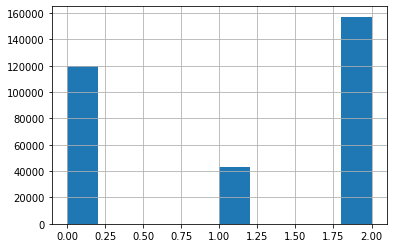

In [23]:
trn['class'].hist()

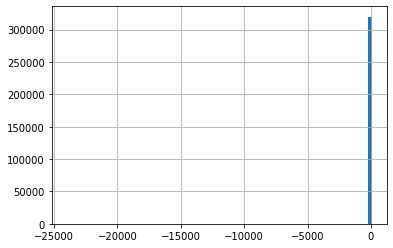

In [25]:
trn['i'].hist(bins=100)

In [26]:
trn['i'].quantile(np.arange(0,1,0.01))    # 1 ~ 100 % 값 만듬

0.00   -23955.817764
0.01       14.457477
0.02       14.873101
0.03       15.095194
0.04       15.249401
            ...     
0.95       19.676923
0.96       19.868159
0.97       20.056154
0.98       20.251694
0.99       20.604561
Name: i, Length: 100, dtype: float64

In [27]:
# check negative number
trn.loc[trn['i']<0]

,u,g,r,i,z,redshift,dered_u,dered_g,dered_r,dered_i,dered_z,nObserve,nDetect,airmass_u,airmass_g,airmass_r,airmass_i,airmass_z,class
id,,,,,,,,,,,,,,,,,,,
107428,19.377354,18.278869,17.940416,-23955.817764,-23955.817764,0.067144,19.11420,18.12698,17.82795,-9999.00000,-9999.00000,5,4,1.306048,1.312059,1.300237,1.303119,1.309028,2
134102,18.059019,19.300850,19.044341,-5.455044,13.428859,0.034934,18.03844,19.48426,19.39370,23.60947,24.11689,1,1,1.069315,1.070952,1.067782,1.068536,1.070121,2
173287,19.983269,-17555.365606,17.909306,-17555.365606,-17555.365606,0.093168,19.77192,-9999.00000,17.81463,-9999.00000,-9999.00000,5,4,1.306051,1.312061,1.300239,1.303120,1.309029,1
181371,14.667977,14.035691,13.758734,-23.902399,13.532917,0.000688,14.58928,13.97676,13.71334,24.45587,13.52639,2,2,1.293286,1.286749,1.299984,1.296625,1.290010,1


In [30]:
trn['dered_i'].quantile(np.arange(0,1,0.01))

0.00   -9999.000000
0.01      14.123798
0.02      14.633757
0.03      14.925560
0.04      15.106960
           ...     
0.95      19.601943
0.96      19.793945
0.97      19.984800
0.98      20.173631
0.99      20.539564
Name: dered_i, Length: 100, dtype: float64

In [31]:
trn.loc[trn['dered_i']<0]

,u,g,r,i,z,redshift,dered_u,dered_g,dered_r,dered_i,dered_z,nObserve,nDetect,airmass_u,airmass_g,airmass_r,airmass_i,airmass_z,class
id,,,,,,,,,,,,,,,,,,,
75409,24.060959,23.887873,20.588958,18.101363,16.431402,0.000170,-30.63370,-18.65599,-8.756023,-3.697258,0.215883,11,8,1.185822,1.185898,1.185876,1.185833,1.185844,0
107428,19.377354,18.278869,17.940416,-23955.817764,-23955.817764,0.067144,19.11420,18.12698,17.827950,-9999.000000,-9999.000000,5,4,1.306048,1.312059,1.300237,1.303119,1.309028,2
173287,19.983269,-17555.365606,17.909306,-17555.365606,-17555.365606,0.093168,19.77192,-9999.00000,17.814630,-9999.000000,-9999.000000,5,4,1.306051,1.312061,1.300239,1.303120,1.309029,1
203328,19.162795,17.793628,16.291881,15.154716,14.254121,0.000214,-35.81847,-25.04575,-13.344300,-6.868285,-2.127095,10,9,1.270983,1.265987,1.276159,1.273547,1.268462,0
218728,22.288621,19.772086,17.677506,16.367164,15.120572,0.000160,-41.07684,-29.46539,-16.380230,-8.941170,-3.705934,6,4,1.185135,1.185212,1.185185,1.185143,1.185157,0
294574,22.728324,20.904907,19.422480,17.877140,17.041118,-0.000007,-42.83753,-30.32076,-16.017210,-8.460405,-2.546173,5,3,1.257923,1.253319,1.262699,1.260288,1.255600,0
295627,23.528590,20.958814,19.451420,17.890094,17.063217,-0.000020,-42.83753,-30.32076,-16.017210,-8.460405,-2.546173,5,3,1.257923,1.253319,1.262699,1.260288,1.255600,0


### Visualization

/usr/local/lib/python3.6/dist-packages/seaborn/axisgrid.py:1912: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


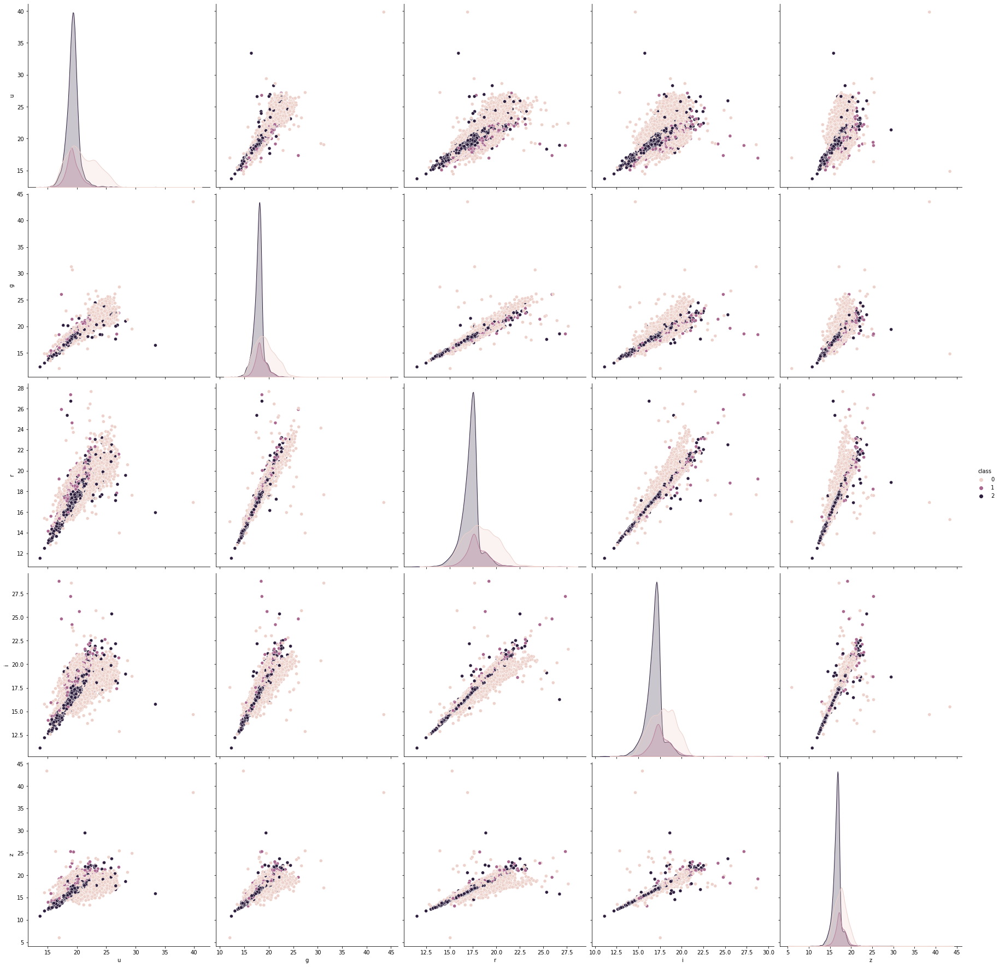

In [33]:
# 32만개 모두 한번에 하면 안되므로 샘플링 함수 사용
trn_sample = trn.sample(n=10000, random_state=seed)
sns.pairplot(data=trn_sample, vars=['u','g','r','i','z'], hue='class', size=5)

/usr/local/lib/python3.6/dist-packages/seaborn/axisgrid.py:1912: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


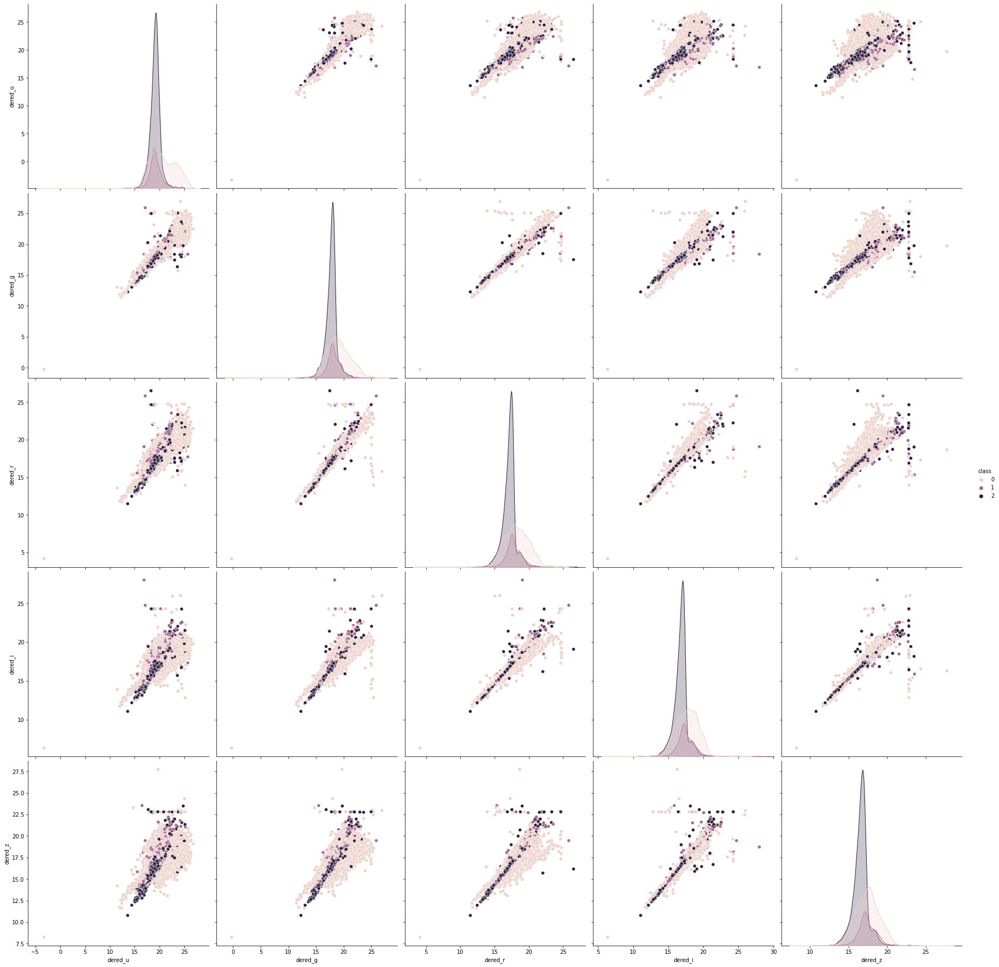

In [34]:
sns.pairplot(data=trn_sample, vars=['dered_u','dered_g','dered_r','dered_i','dered_z'], hue='class', size=5)

/usr/local/lib/python3.6/dist-packages/seaborn/axisgrid.py:1912: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


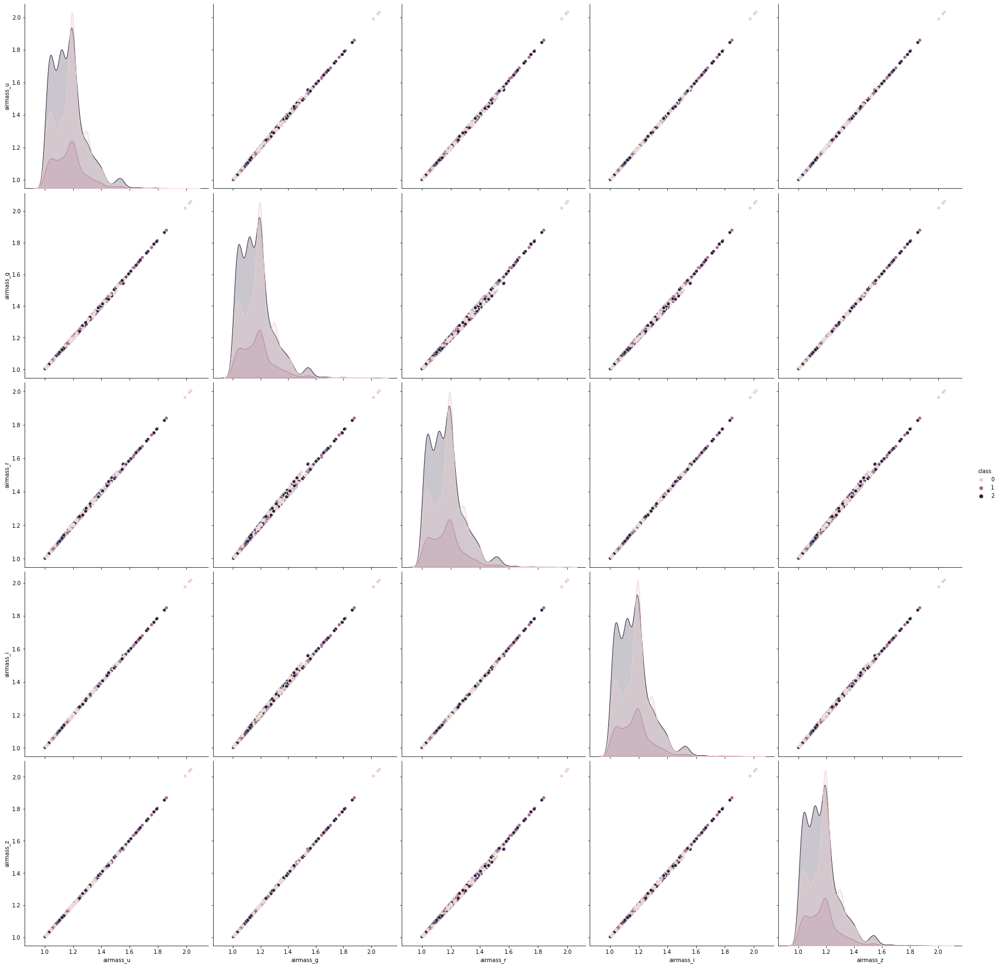

In [35]:
sns.pairplot(data=trn_sample, vars=['airmass_u','airmass_g','airmass_r','airmass_i','airmass_z'], hue='class', size=5)

# 거의 일치하므로 이 중 하나만 있으면 되겠구나 라는 유추를 할 수 있다.

/usr/local/lib/python3.6/dist-packages/seaborn/axisgrid.py:1912: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


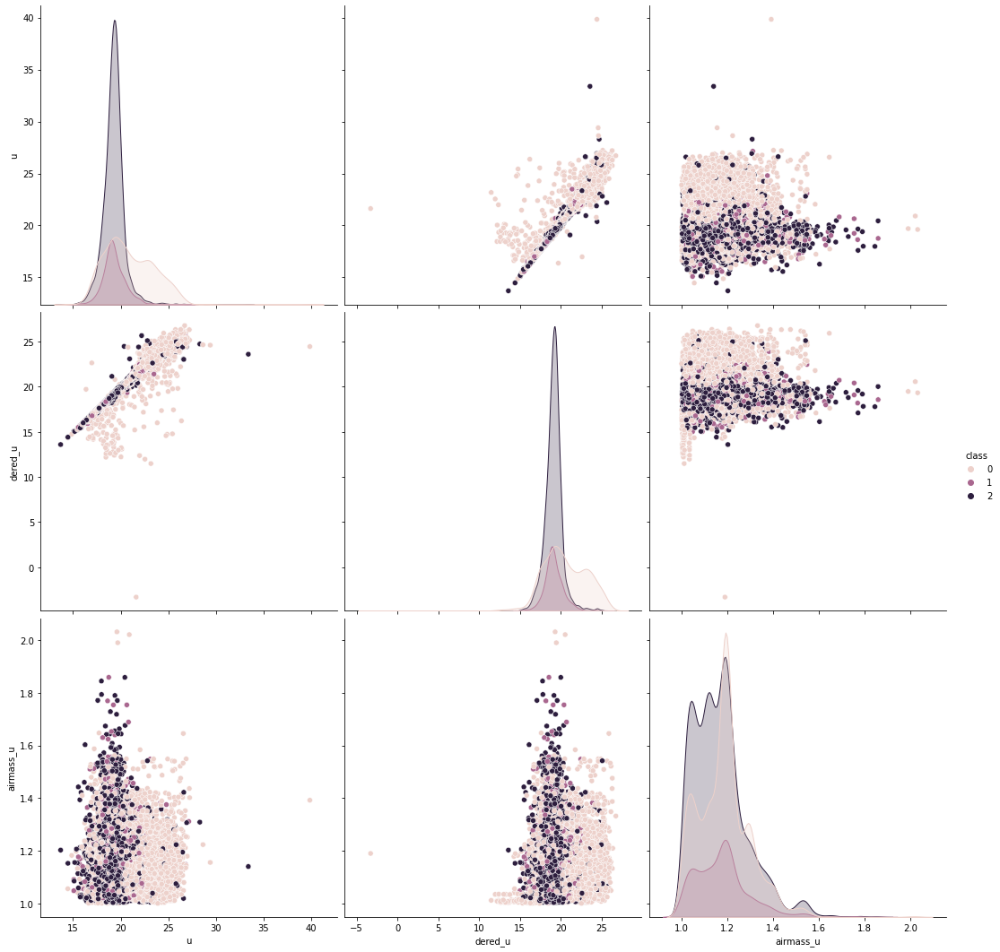

In [38]:
sns.pairplot(data=trn_sample, vars=['u','dered_u','airmass_u'], hue='class', size=5)

/usr/local/lib/python3.6/dist-packages/seaborn/axisgrid.py:1912: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


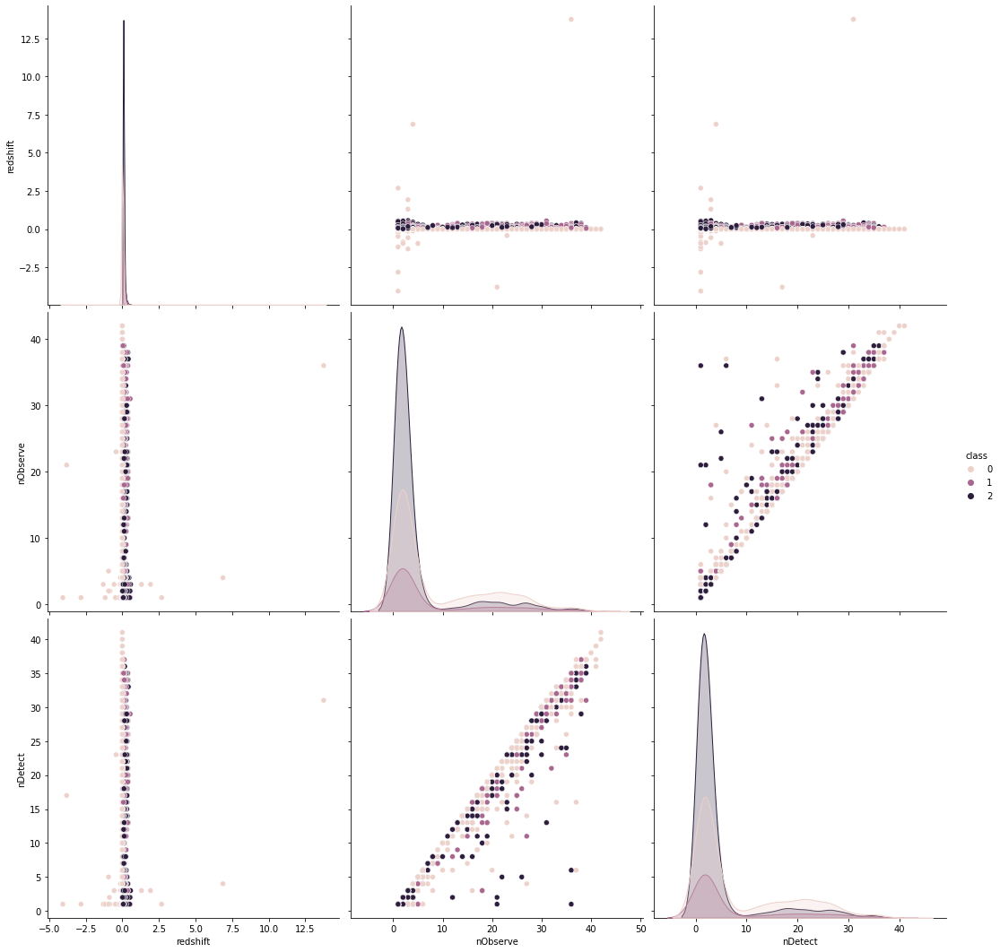

In [37]:
sns.pairplot(data=trn_sample, vars=['redshift','nObserve','nDetect'], hue='class', size=5)

In [39]:
# groupby : 하나의 기준을 group으로 만들고 계산을 할때 사용
trn.groupby('class').mean()

,u,g,r,i,z,redshift,dered_u,dered_g,dered_r,dered_i,dered_z,nObserve,nDetect,airmass_u,airmass_g,airmass_r,airmass_i,airmass_z
class,,,,,,,,,,,,,,,,,,
0,20.864765,19.212870,18.393820,17.837675,17.552763,-0.002378,20.522285,18.947407,18.210012,17.701107,17.451053,8.555277,8.313777,1.186403,1.187333,1.185609,1.185989,1.186850
1,19.270955,17.877632,17.841178,17.133305,17.005751,0.105495,19.107144,17.926739,17.752646,17.244695,17.134281,7.045133,6.758794,1.177619,1.178420,1.176952,1.177268,1.178002
2,19.238012,17.874594,17.204815,16.678991,16.322502,0.091784,19.088967,17.759045,17.124288,16.708381,16.353124,4.442459,4.310077,1.167138,1.167767,1.166639,1.166871,1.167435


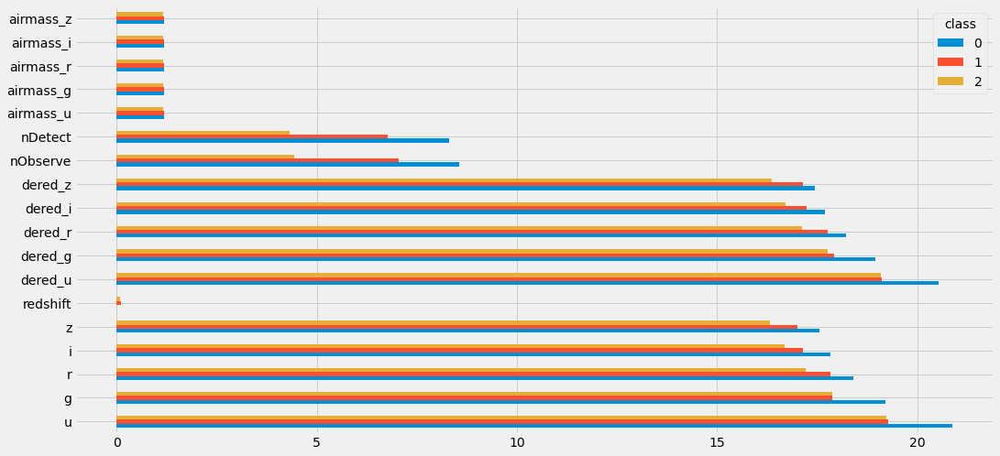

In [43]:
trn.groupby('class').mean().T.plot(kind='barh')

### test data

In [47]:
print(tst.shape)
tst.head()

(80000, 18)


,u,g,r,i,z,redshift,dered_u,dered_g,dered_r,dered_i,dered_z,nObserve,nDetect,airmass_u,airmass_g,airmass_r,airmass_i,airmass_z
id,,,,,,,,,,,,,,,,,,
320000,19.1431,18.0172,17.4733,17.1144,16.9263,1.2130e-01,19.0750,17.9550,17.4308,17.0838,16.9087,1,1,1.1563,1.1515,1.1613,1.1588,1.1539
320001,18.7409,17.1705,16.3691,15.9865,15.7307,-6.6907e-05,15.0703,14.3098,14.3901,14.5160,14.6372,2,2,1.0076,1.0074,1.0080,1.0078,1.0075
320002,19.2980,17.8803,17.2221,16.8096,16.6352,1.1001e-01,19.1004,17.7726,17.1460,16.7497,16.5689,1,1,1.3809,1.3905,1.3715,1.3761,1.3856
320003,18.0775,17.1569,16.9041,16.8118,16.7955,2.9697e-05,17.9729,17.0735,16.8470,16.7700,16.7668,1,1,1.1408,1.1408,1.1409,1.1408,1.1408
320004,17.8325,16.7646,16.2135,15.8722,15.6621,6.8471e-02,17.7545,16.6794,16.1563,15.8315,15.6433,2,2,1.1110,1.1077,1.1145,1.1127,1.1093


### train, test concatenation

In [48]:
df = pd.concat([trn, tst], axis=0) # 위아래 결합
print(df.shape)
df.tail()

(400000, 19)


,u,g,r,i,z,redshift,dered_u,dered_g,dered_r,dered_i,dered_z,nObserve,nDetect,airmass_u,airmass_g,airmass_r,airmass_i,airmass_z,class
id,,,,,,,,,,,,,,,,,,,
399995,19.6734,18.6617,18.2708,18.1225,18.0627,-0.0003,19.3361,18.3933,18.0860,17.9861,17.9670,17,17,1.1858,1.1863,1.1855,1.1857,1.1861,NaN
399996,21.5229,20.7283,20.6087,21.0049,20.8458,0.0655,21.3993,20.6399,20.5451,20.9507,20.7827,8,4,1.2850,1.2908,1.2793,1.2821,1.2878,NaN
399997,19.3991,18.2411,18.1605,18.1978,18.2018,-0.0008,18.9136,17.8753,17.9047,18.0043,18.0400,1,1,1.1885,1.1886,1.1885,1.1885,1.1885,NaN
399998,18.8997,17.6009,17.1329,16.8223,16.5946,0.0428,18.7715,17.4880,17.0557,16.7660,16.5585,17,17,1.1804,1.1813,1.1797,1.1800,1.1809,NaN
399999,20.7587,20.4252,20.5362,20.7729,20.9698,0.0003,20.4958,20.2181,20.3939,20.6696,20.9085,5,5,1.1832,1.1775,1.1889,1.1860,1.1803,NaN


In [49]:
df.fillna(-1, inplace=True) # 0은 값이기 때문에 넣으면 안됨
df.tail()

,u,g,r,i,z,redshift,dered_u,dered_g,dered_r,dered_i,dered_z,nObserve,nDetect,airmass_u,airmass_g,airmass_r,airmass_i,airmass_z,class
id,,,,,,,,,,,,,,,,,,,
399995,19.6734,18.6617,18.2708,18.1225,18.0627,-0.0003,19.3361,18.3933,18.0860,17.9861,17.9670,17,17,1.1858,1.1863,1.1855,1.1857,1.1861,-1.0
399996,21.5229,20.7283,20.6087,21.0049,20.8458,0.0655,21.3993,20.6399,20.5451,20.9507,20.7827,8,4,1.2850,1.2908,1.2793,1.2821,1.2878,-1.0
399997,19.3991,18.2411,18.1605,18.1978,18.2018,-0.0008,18.9136,17.8753,17.9047,18.0043,18.0400,1,1,1.1885,1.1886,1.1885,1.1885,1.1885,-1.0
399998,18.8997,17.6009,17.1329,16.8223,16.5946,0.0428,18.7715,17.4880,17.0557,16.7660,16.5585,17,17,1.1804,1.1813,1.1797,1.1800,1.1809,-1.0
399999,20.7587,20.4252,20.5362,20.7729,20.9698,0.0003,20.4958,20.2181,20.3939,20.6696,20.9085,5,5,1.1832,1.1775,1.1889,1.1860,1.1803,-1.0


### 피쳐 변환

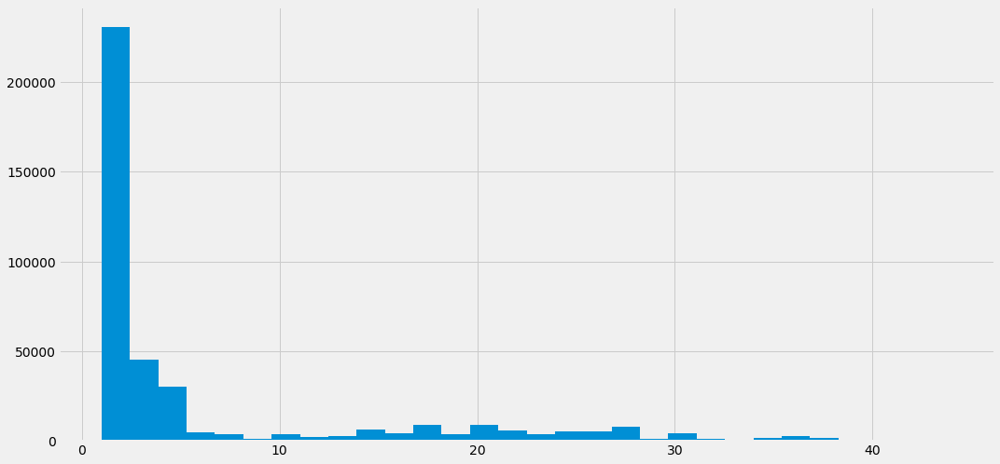

In [50]:
df['nObserve'].hist(bins=30) # Too skewed

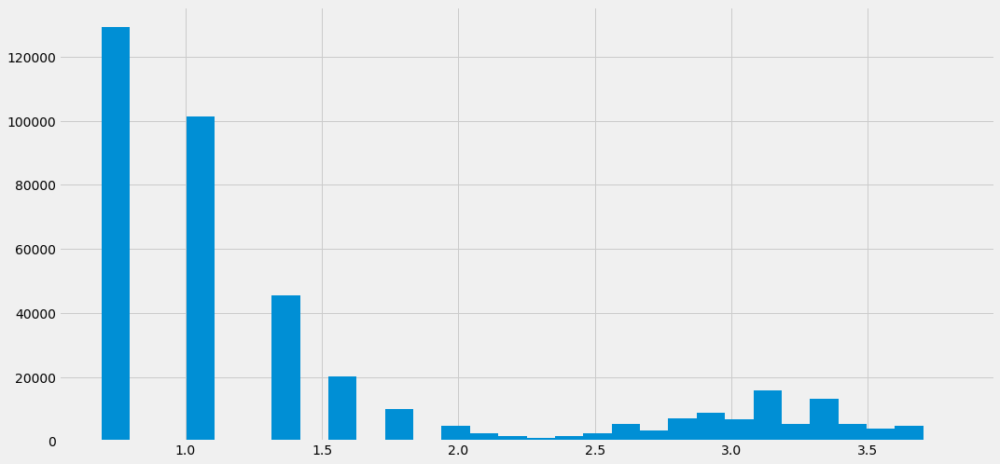

In [51]:
df['nObserve'] = df['nObserve'].apply(np.log1p)
df['nObserve'].hist(bins=30)

### 피쳐 생성

In [52]:
df['d_dered_u'] = df['dered_u'] - df['u']
df['d_dered_g'] = df['dered_g'] - df['g']
df['d_dered_r'] = df['dered_r'] - df['r']
df['d_dered_i'] = df['dered_i'] - df['i']
df['d_dered_z'] = df['dered_z'] - df['z']
df['d_dered_rg'] = df['dered_r'] - df['dered_g']
df['d_dered_ig'] = df['dered_i'] - df['dered_g']
df['d_dered_zg'] = df['dered_z'] - df['dered_g']
df['d_dered_ri'] = df['dered_r'] - df['dered_i']
df['d_dered_rz'] = df['dered_r'] - df['dered_z']
df['d_dered_iz'] = df['dered_i'] - df['dered_z']
df['d_obs_det'] = df['nObserve'] - df['nDetect']
print(df.shape)
df.head()

(400000, 31)


,u,g,r,i,z,redshift,dered_u,dered_g,dered_r,dered_i,dered_z,nObserve,nDetect,airmass_u,airmass_g,airmass_r,airmass_i,airmass_z,class,d_dered_u,d_dered_g,d_dered_r,d_dered_i,d_dered_z,d_dered_rg,d_dered_ig,d_dered_zg,d_dered_ri,d_dered_rz,d_dered_iz,d_obs_det
id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,23.2640,20.3368,19.0095,17.6724,16.9396,-8.1086e-05,23.1243,20.2578,18.9551,17.6321,16.9089,2.9444,18,1.1898,1.1907,1.1890,1.1894,1.1902,0.0,-0.1397,-0.0790,-0.0544,-0.0403,-0.0307,-1.3027,-2.6257,-3.3488,1.3230,2.0462,0.7232,-15.0556
1,15.0521,14.0620,13.4524,13.2684,13.1689,4.5061e-03,14.9664,14.0045,13.4114,13.2363,13.1347,0.6931,1,1.2533,1.2578,1.2488,1.2510,1.2555,1.0,-0.0857,-0.0574,-0.0410,-0.0322,-0.0343,-0.5931,-0.7683,-0.8698,0.1751,0.2767,0.1016,-0.3069
2,16.7864,15.8254,15.5363,15.3935,15.3500,4.7198e-04,16.6076,15.6866,15.4400,15.3217,15.2961,1.0986,2,1.0225,1.0241,1.0210,1.0217,1.0233,0.0,-0.1787,-0.1388,-0.0963,-0.0718,-0.0540,-0.2466,-0.3649,-0.3905,0.1183,0.1440,0.0257,-0.9014
3,25.6606,21.1887,20.2212,19.8949,19.6346,5.8143e-06,25.3536,20.9947,20.0873,19.7947,19.5552,1.6094,3,1.2054,1.2061,1.2049,1.2051,1.2057,0.0,-0.3070,-0.1941,-0.1339,-0.1003,-0.0795,-0.9074,-1.2000,-1.4395,0.2926,0.5321,0.2395,-1.3906
4,24.4534,20.6992,19.0424,18.3242,17.9826,-3.3247e-05,23.7714,20.4338,18.8630,18.1903,17.8759,2.6391,12,1.1939,1.1943,1.1937,1.1938,1.1941,0.0,-0.6820,-0.2653,-0.1794,-0.1339,-0.1067,-1.5709,-2.2436,-2.5579,0.6727,0.9871,0.3144,-9.3609


### 피쳐 삭제

In [53]:
df.corr().style.background_gradient()
# u, dered_u 는 비슷하므로 하나만 사용해도 되겠다는 결론 도출 가능
# airmass column들은 상관계수가 거의 1 => 하나만 사용해도 ㄱㅊ

,u,g,r,i,z,redshift,dered_u,dered_g,dered_r,dered_i,dered_z,nObserve,nDetect,airmass_u,airmass_g,airmass_r,airmass_i,airmass_z,class,d_dered_u,d_dered_g,d_dered_r,d_dered_i,d_dered_z,d_dered_rg,d_dered_ig,d_dered_zg,d_dered_ri,d_dered_rz,d_dered_iz,d_obs_det
u,1.0000,0.0543,0.8159,0.0194,0.0145,-0.0085,0.9347,0.0904,0.7810,0.0389,0.0231,0.2398,0.2211,0.0768,0.0765,0.0769,0.0768,0.0767,-0.2378,-0.2140,-0.0061,-0.1284,-0.0016,0.0016,-0.0182,-0.0357,-0.0196,0.0124,0.0094,0.0020,-0.2174
g,0.0543,1.0000,0.0556,0.5913,0.5315,-0.0003,0.0525,0.9987,0.0538,0.7074,0.4478,0.0130,0.0127,0.0027,0.0027,0.0028,0.0027,0.0027,-0.0142,-0.0069,-0.9977,-0.0063,-0.4753,-0.3233,-0.9986,-0.0021,-0.0011,-0.7049,-0.4458,0.0001,-0.0126
r,0.8159,0.0556,1.0000,0.0256,0.0199,-0.0055,0.8037,0.0953,0.9684,0.0530,0.0330,0.2171,0.1954,0.0772,0.0768,0.0774,0.0773,0.0770,-0.2346,-0.0620,-0.0025,-0.1127,-0.0005,0.0036,-0.0057,-0.0207,-0.0110,0.0106,0.0073,0.0007,-0.1915
i,0.0194,0.5913,0.0256,1.0000,0.8991,-0.0001,0.0195,0.5901,0.0252,0.9878,0.6254,0.0054,0.0061,-0.0002,-0.0003,-0.0001,-0.0002,-0.0002,-0.0079,-0.0005,-0.5904,-0.0010,-0.9903,-0.6738,-0.5907,0.8047,0.4028,-0.9876,-0.6247,0.0000,-0.0061
z,0.0145,0.5315,0.0199,0.8991,1.0000,-0.0002,0.0144,0.5303,0.0196,0.8881,0.7096,0.0042,0.0053,-0.0002,-0.0002,-0.0001,-0.0002,-0.0002,-0.0083,-0.0009,-0.5309,-0.0007,-0.8904,-0.7360,-0.5311,0.7237,0.5270,-0.8881,-0.7092,-0.1904,-0.0054
redshift,-0.0085,-0.0003,-0.0055,-0.0001,-0.0002,1.0000,-0.0080,-0.0002,-0.0028,-0.0001,-0.0001,-0.0092,-0.0067,0.0011,0.0011,0.0011,0.0011,0.0011,0.0484,0.0016,0.0005,0.0106,0.0002,0.0001,-0.0001,0.0001,-0.0000,-0.0001,-0.0000,0.0001,0.0064
dered_u,0.9347,0.0525,0.8037,0.0195,0.0144,-0.0080,1.0000,0.0969,0.8392,0.0423,0.0249,0.2337,0.2172,0.0889,0.0885,0.0892,0.0891,0.0887,-0.2120,0.1470,0.0068,0.1521,0.0013,0.0036,-0.0194,-0.0374,-0.0209,0.0128,0.0100,0.0025,-0.2138
dered_g,0.0904,0.9987,0.0953,0.5901,0.5303,-0.0002,0.0969,1.0000,0.0990,0.7072,0.4476,0.0222,0.0212,0.0071,0.0070,0.0072,0.0071,0.0070,-0.0219,0.0149,-0.9928,0.0158,-0.4733,-0.3218,-0.9957,-0.0037,-0.0020,-0.7018,-0.4437,0.0002,-0.0209
dered_r,0.7810,0.0538,0.9684,0.0252,0.0196,-0.0028,0.8392,0.0990,1.0000,0.0549,0.0340,0.2100,0.1899,0.0848,0.0843,0.0852,0.0850,0.0845,-0.2139,0.1329,0.0065,0.1388,0.0018,0.0048,-0.0065,-0.0217,-0.0117,0.0108,0.0076,0.0010,-0.1863
dered_i,0.0389,0.7074,0.0530,0.9878,0.8881,-0.0001,0.0423,0.7072,0.0549,1.0000,0.6331,0.0118,0.0119,0.0026,0.0026,0.0027,0.0027,0.0026,-0.0136,0.0080,-0.7048,0.0082,-0.9566,-0.6508,-0.7056,0.7044,0.3526,-0.9978,-0.6312,0.0000,-0.0119


In [54]:
df.drop(['airmass_z', 'airmass_i', 'airmass_r', 'airmass_g', 'u', 'g', 'r', 'i', 'nDetect', 'd_dered_rg', 'd_dered_ri'], 
        axis=1, inplace=True)
print(df.shape)
df.head()

(400000, 20)


,z,redshift,dered_u,dered_g,dered_r,dered_i,dered_z,nObserve,airmass_u,class,d_dered_u,d_dered_g,d_dered_r,d_dered_i,d_dered_z,d_dered_ig,d_dered_zg,d_dered_rz,d_dered_iz,d_obs_det
id,,,,,,,,,,,,,,,,,,,,
0,16.9396,-8.1086e-05,23.1243,20.2578,18.9551,17.6321,16.9089,2.9444,1.1898,0.0,-0.1397,-0.0790,-0.0544,-0.0403,-0.0307,-2.6257,-3.3488,2.0462,0.7232,-15.0556
1,13.1689,4.5061e-03,14.9664,14.0045,13.4114,13.2363,13.1347,0.6931,1.2533,1.0,-0.0857,-0.0574,-0.0410,-0.0322,-0.0343,-0.7683,-0.8698,0.2767,0.1016,-0.3069
2,15.3500,4.7198e-04,16.6076,15.6866,15.4400,15.3217,15.2961,1.0986,1.0225,0.0,-0.1787,-0.1388,-0.0963,-0.0718,-0.0540,-0.3649,-0.3905,0.1440,0.0257,-0.9014
3,19.6346,5.8143e-06,25.3536,20.9947,20.0873,19.7947,19.5552,1.6094,1.2054,0.0,-0.3070,-0.1941,-0.1339,-0.1003,-0.0795,-1.2000,-1.4395,0.5321,0.2395,-1.3906
4,17.9826,-3.3247e-05,23.7714,20.4338,18.8630,18.1903,17.8759,2.6391,1.1939,0.0,-0.6820,-0.2653,-0.1794,-0.1339,-0.1067,-2.2436,-2.5579,0.9871,0.3144,-9.3609


### 새로운 학습 데이터 파일 저장

In [57]:
data_dir=Path('../input/')
feature_file = data_dir / 'feature.csv'
seed = 42

In [59]:
df.to_csv(feature_file)

FileNotFoundError: ignored